# Predicting Chicago Rideshare Costs | Visualizations
#### Alison Bertin, Alpha Nayarera, Matthew Echols
Big Data | June 4, 2019

In [1]:
from pyspark.sql import SparkSession
from pyspark.sql import functions as F
from pyspark.sql.functions import isnan, when, count, col, lit, udf, month, year, date_format, datediff, from_unixtime, unix_timestamp
from pyspark.sql.functions import date_trunc
from datetime import datetime, timedelta
from dateutil.relativedelta import relativedelta
from pyspark.sql.window import Window
from pyspark.sql.types import (StructType, StructField, DateType, BooleanType,
                               DoubleType, IntegerType, StringType, TimestampType)
from functools import reduce
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
!hdfs dfs -put /home/abertin/data/CommunityNames3.csv /user/abertin/data/

Java HotSpot(TM) 64-Bit Server VM warning: ignoring option MaxPermSize=512M; support was removed in 8.0
put: `/user/abertin/data/CommunityNames3.csv': File exists


In [3]:
!hdfs dfs -ls /user/mechols/data/
!hdfs dfs -ls /user/abertin/data/

Java HotSpot(TM) 64-Bit Server VM warning: ignoring option MaxPermSize=512M; support was removed in 8.0
Found 8 items
-rw-r--r--   3 mechols mechols      375182 2019-05-26 23:15 /user/mechols/data/AllWeather.csv
-rw-r--r--   3 mechols mechols        1708 2019-05-17 14:10 /user/mechols/data/chicago_community_names.csv
-rw-r--r--   3 mechols mechols  1804333782 2019-05-16 21:03 /user/mechols/data/chicago_crimes.csv
-rw-r--r--   3 mechols mechols   208276005 2019-04-30 20:04 /user/mechols/data/food-inspections.csv
drwxr-xr-x   - mechols mechols           0 2019-06-03 15:23 /user/mechols/data/fulldf.csv
-rw-r--r--   3 mechols mechols 11980344386 2019-05-21 14:25 /user/mechols/data/rows.csv
drwxr-xr-x   - mechols mechols           0 2019-05-26 17:22 /user/mechols/data/weatherTrial
drwxr-xr-x   - mechols mechols           0 2019-05-25 11:15 /user/mechols/data/weather_data
Java HotSpot(TM) 64-Bit Server VM warning: ignoring option MaxPermSize=512M; support was removed in 8.0
Found 207 items
-

-rw-r--r--   3 abertin abertin   10851049 2019-05-27 08:35 /user/abertin/data/part-00078-46422c81-c4dc-4f08-8735-a6c7671c857e-c000.snappy.parquet
-rw-r--r--   3 abertin abertin   10047786 2019-05-27 08:35 /user/abertin/data/part-00079-46422c81-c4dc-4f08-8735-a6c7671c857e-c000.snappy.parquet
-rw-r--r--   3 abertin abertin    9812997 2019-05-27 08:35 /user/abertin/data/part-00080-46422c81-c4dc-4f08-8735-a6c7671c857e-c000.snappy.parquet
-rw-r--r--   3 abertin abertin   13208798 2019-05-27 08:35 /user/abertin/data/part-00081-46422c81-c4dc-4f08-8735-a6c7671c857e-c000.snappy.parquet
-rw-r--r--   3 abertin abertin   10340596 2019-05-27 08:35 /user/abertin/data/part-00082-46422c81-c4dc-4f08-8735-a6c7671c857e-c000.snappy.parquet
-rw-r--r--   3 abertin abertin   12047935 2019-05-27 08:35 /user/abertin/data/part-00083-46422c81-c4dc-4f08-8735-a6c7671c857e-c000.snappy.parquet
-rw-r--r--   3 abertin abertin   18715816 2019-05-27 08:35 /user/abertin/data/part-00084-46422c81-c4dc-4f08-8735-a6c7671c857

In [4]:
spark = SparkSession.builder.appName('RideShareViz').getOrCreate()
conf = spark.sparkContext._conf.setAll([('spark.executor.memory', '256g'),
                                        ('spark.app.name', 'Spark Updated Conf'),
                                        ('spark.executor.cores', '16'),
                                        ('spark.cores.max', '16'),
                                        ('spark.driver.memory','256g'),
                                        ('spark.sql.AutoBroadcastJoinThreshold', -1),
                                        ('mapreduce.reduce.memory.mb',-1),
                                        ('spark.yarn.executor.memoryOverhead', -1),
                                        ('spark.kryoserializer.buffer.max.mb', '5g')])

In [5]:
rides = sqlContext.read.format('csv').options(header='true', inferSchema = True).load("/user/mechols/data/fulldf.csv")

In [6]:
rides.printSchema()

root
 |-- seconds: integer (nullable = true)
 |-- miles: double (nullable = true)
 |-- communityPickup: integer (nullable = true)
 |-- communityDropoff: integer (nullable = true)
 |-- fare: double (nullable = true)
 |-- shared: boolean (nullable = true)
 |-- pickupLat: double (nullable = true)
 |-- pickupLong: double (nullable = true)
 |-- dropoffLat: double (nullable = true)
 |-- dropoffLong: double (nullable = true)
 |-- apparentTemperature: double (nullable = true)
 |-- humidity: double (nullable = true)
 |-- precipIntensity: double (nullable = true)
 |-- precipProbability: double (nullable = true)
 |-- temperature: double (nullable = true)
 |-- Cloudy: double (nullable = true)
 |-- Rainy: double (nullable = true)
 |-- Snowy: double (nullable = true)
 |-- month: integer (nullable = true)
 |-- day: integer (nullable = true)
 |-- hour: integer (nullable = true)



##### Total Fares = $369,533,207 over 5 month Period

In [20]:
sum_fare = rides.agg({"fare":"sum"}).collect()[0]
result = sum_fare["sum(fare)"]
result

369533207.5

#### NEIGHBORHOODS - Matching to Community Area

In [8]:
import datetime
from pyspark.sql.functions import *

area = sqlContext.read.format('csv').options(header='true', inferSchema = True).load("/user/abertin/data/CommunityNames3.csv")
#area.select('community_id').count()
area.printSchema()

root
 |-- community_id: string (nullable = true)
 |-- name: string (nullable = true)



In [9]:
rides = rides.join(area, rides.communityPickup == area.community_id, 'left')

In [10]:
oldColumns = rides.schema.names
newColumns = ['seconds','miles','communityPickup','communityDropoff','fare',
 'shared','pickupLat','pickupLong','dropoffLat','dropoffLong', 'apparentTemperature', 'humidity',
 'precipIntensity', 'precipProbability', 'temperature', 'Cloudy', 'Rainy', 'Snowy', 'month',
 'day','hour','community_id', 'pickupArea']
rides = reduce(lambda rides, idx: rides.withColumnRenamed(oldColumns[idx], newColumns[idx]), range(len(oldColumns)), rides)

In [11]:
rides = rides.join(area, rides.communityDropoff == area.community_id, 'left')

In [12]:
oldColumns = rides.schema.names
newColumns = ['seconds','miles','communityPickup','communityDropoff','fare',
 'shared','pickupLat','pickupLong','dropoffLat','dropoffLong', 'apparentTemperature', 'humidity',
 'precipIntensity', 'precipProbability', 'temperature', 'Cloudy', 'Rainy', 'Snowy', 'month',
 'day','hour','community_id', 'pickupArea', 'community_id2','dropoffArea']
rides = reduce(lambda rides, idx: rides.withColumnRenamed(oldColumns[idx], newColumns[idx]), range(len(oldColumns)), rides)
rides.printSchema()

root
 |-- seconds: integer (nullable = true)
 |-- miles: double (nullable = true)
 |-- communityPickup: integer (nullable = true)
 |-- communityDropoff: integer (nullable = true)
 |-- fare: double (nullable = true)
 |-- shared: boolean (nullable = true)
 |-- pickupLat: double (nullable = true)
 |-- pickupLong: double (nullable = true)
 |-- dropoffLat: double (nullable = true)
 |-- dropoffLong: double (nullable = true)
 |-- apparentTemperature: double (nullable = true)
 |-- humidity: double (nullable = true)
 |-- precipIntensity: double (nullable = true)
 |-- precipProbability: double (nullable = true)
 |-- temperature: double (nullable = true)
 |-- Cloudy: double (nullable = true)
 |-- Rainy: double (nullable = true)
 |-- Snowy: double (nullable = true)
 |-- month: integer (nullable = true)
 |-- day: integer (nullable = true)
 |-- hour: integer (nullable = true)
 |-- community_id2: string (nullable = true)
 |-- pickupArea: string (nullable = true)
 |-- community_id2: string (nullable =

In [15]:
rides.select('pickupLat','dropoffLat','pickupArea','dropoffArea','communityPickup','communityDropoff','miles').show(5)

+-------------+-------------+-------------------+--------------+---------------+----------------+-----+
|    pickupLat|   dropoffLat|         pickupArea|   dropoffArea|communityPickup|communityDropoff|miles|
+-------------+-------------+-------------------+--------------+---------------+----------------+-----+
|41.9581548757|41.9854764991|             Uptown|     Edgewater|              3|              77|  3.0|
|41.7402057565|41.7402057565|            Chatham|       Chatham|             44|              44|  1.9|
|41.8785943576|41.7442051463|West Garfield Park |Auburn Gresham|             26|              71| 14.7|
|41.7788768603|41.8090844303|           Woodlawn|   Fuller Park|             42|              37|  3.9|
|41.9850151008|41.9850151008|       Norwood Park|  Norwood Park|             10|              10|  1.2|
+-------------+-------------+-------------------+--------------+---------------+----------------+-----+
only showing top 5 rows



# Visualizations Overview

https://datascience-enthusiast.com/Python/SparkDataFrames-ExploringChicagoCrimes.html

https://towardsdatascience.com/a-step-by-step-guide-for-creating-advanced-python-data-visualizations-with-seaborn-matplotlib-1579d6a1a7d0

#### Tested using subsample of Rides data. 

In [15]:
rides2 = rides.sample(False, 0.01, seed=0)
rides2PDF = rides2.toPandas()

In [17]:
#from pyspark.sql import SparkContext
import pyspark.sql.functions as f
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import *

#sns.set(color_codes=True)

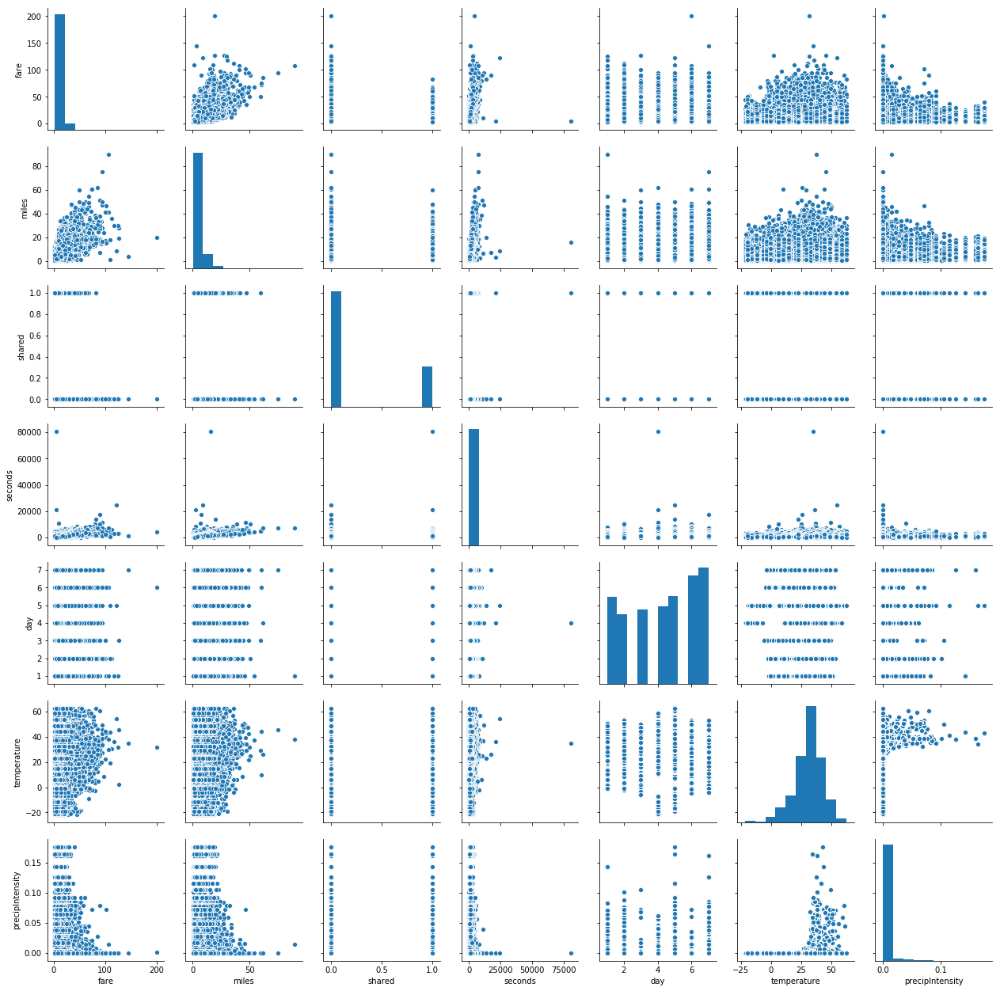

In [44]:
data = rides2PDF[['fare', 'miles', 'shared', 'seconds', 'day','temperature',
                  'precipIntensity']]
sns.pairplot(data)

TIME DISTRIBUTION

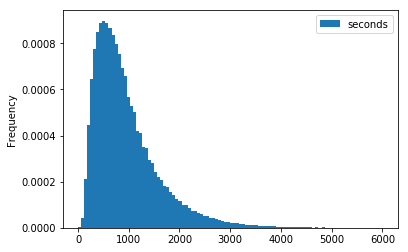

In [58]:
time = rides2.select('seconds').toPandas()
ax = time.plot.hist(bins=100, alpha=1.0,density=1, range=[0.0, 6000.0])

In [59]:
lessThan10min = time[time < 600.0].count()
totalrides = time.count()
PercentRidesLess10min = lessThan10min/totalrides
print('Percent of Rides Less Than 10 min', PercentRidesLess10min)

Percent of Rides Less Than 10 min seconds    0.339014
dtype: float64


In [63]:
lessThan15min = time[time < 900.0].count()
totalrides = time.count()
PercentRidesLess15min = lessThan15min/totalrides
print('Percent of Rides Less Than 15 min', PercentRidesLess15min)

Percent of Rides Less Than 15 min seconds    0.575764
dtype: float64


MILES DISTRIBUTION

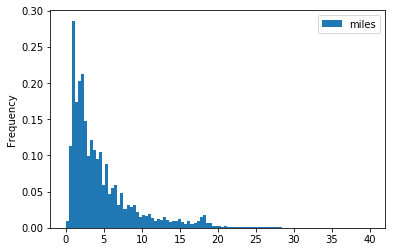

In [18]:
#rides2.groupBy("tripID").count().rdd.values().histogram()
miles = rides2.select('miles').toPandas()
ax = miles.plot.hist(bins=100, alpha=1.0,density=1, range=[0.0, 40.0])

###### Over 68% of the Total Rides Taken Over the 5month Test Period Were Less Than 5 Miles in Distance

In [14]:
lessThan5 = miles[miles < 5.0].count()
totalrides = miles.count()
PercentRidesLess5 = lessThan5/totalrides
print('Percent of Rides Less Than 5 Miles:', PercentRidesLess5)

Percent of Rides Less Than 5 Miles: miles    0.682146
dtype: float64


In [20]:
lessThan2 = miles[miles < 2.0].count()
totalrides = miles.count()
PercentRidesLess2 = lessThan2/totalrides
print('Percent of Rides Less Than 2 Miles:', PercentRidesLess2)

Percent of Rides Less Than 2 Miles: miles    0.314824
dtype: float64


FARE DISTRIBUTION

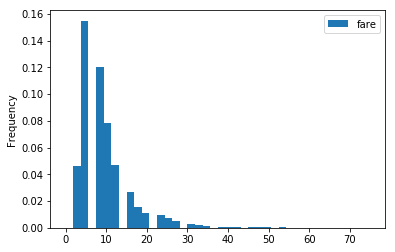

In [21]:
fares = rides2.select('fare').toPandas()
axF = fares.plot.hist(bins=40, alpha=1.0, density = 1, range=[0.0, 75.0])

###### 60% of the Total Rides Taken Over the 5month Test Period Were Less Than a 10 Dollar Fare

In [22]:
lessThan10 = fares[fares < 10.0].count()
totalFares = fares.count()
PercentRidesLess10 = lessThan10/totalFares
print('Percent of Rides Less Than $10:', PercentRidesLess10)

lessThan10

Percent of Rides Less Than $10: fare    0.602917
dtype: float64


fare    236012
dtype: int64

In [23]:
lessThan5dolloars = fares[fares < 5.0].count()
totalFares = fares.count()
PercentRidesLess5dollars = lessThan5dolloars/totalFares
print('Percent of Rides Less Than $5:', PercentRidesLess5dollars)

lessThan5dolloars

Percent of Rides Less Than $5: fare    0.086818
dtype: float64


fare    33985
dtype: int64

###### Trips By Day

In [39]:
AvgbyDay = rides.groupBy('day').agg({'day': 'count', 'fare': 'mean'})
AvgbyDayP = AvgbyDay.toPandas()

AVG FARE BY DAY
- Slight variation in average fare with Sunday(1) and Saturday (7) having lowest fares - possibly due to larger supply of drivers on weekend. 

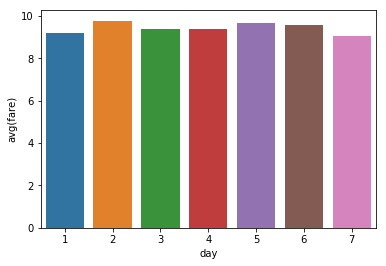

In [42]:
sns.barplot(x='day',y='avg(fare)',data=AvgbyDayP)

RIDES PER HOUR BY DAY

- Weekends see a significant dip during 'morning rush hour' but also see a significant increase during evening hours vs week days. 
- Saturday(7) and Sunday (1) have a large spike in in the very early hours of the morning as Chicagoans head home from the bars.  

In [15]:
temp = rides.select("day", rides['hour'].cast('int').alias('hour'))
hourlyCount  = temp.groupBy(["day","hour"]).count().collect()

days = [item[0] for item in hourlyCount]
hours = [item[1] for item in hourlyCount]
count = [item[2] for item in hourlyCount]

rides_byHour = {"count": count, "hours": hours, "days": days}
rides_byHour = pd.DataFrame(rides_byHour)
rides_byHour = rides_byHour.sort_values(by = "hours", ascending  = True)

/software/Anaconda3-5.1.0-hadoop/lib/python3.6/site-packages/seaborn/axisgrid.py:230: UserWarning: The `size` paramter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


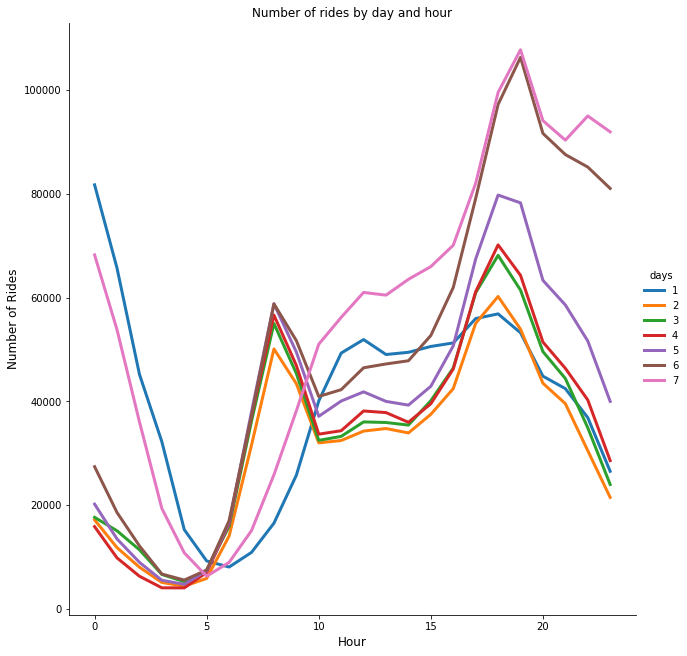

In [16]:
import seaborn as sns

g = sns.FacetGrid(rides_byHour, hue="days", size = 9)
g.map(plt.plot, "hours", "count", linewidth = 3)
g.add_legend()

plt.ylabel("Number of Rides", fontsize = 12)
plt.xlabel("Hour", fontsize = 12)
plt.title("Number of rides by day and hour", fontsize = 12)
plt.xticks(size = 10)
plt.yticks(size = 10)

#DAYS = ['MONDAY', 'TUESDAY', 'WEDNESDAY', 'THURSDAY', 'FRIDAY', 'SATURDAY', 'SUNDAY']
#rides.date.value_counts().reindex(DAYS, fill_value=0).plt.plot() check index

plt.show()

### Weather Overview

What is the best way to aggregate Cloudy, Rainy, Snowy to visualize?? 

In [49]:
weather = rides.groupBy('Cloudy', 'Rainy','Snowy').count().sort(desc('count'))
weather.show(3)

+------+-----+-----+--------+
|Cloudy|Rainy|Snowy|   count|
+------+-----+-----+--------+
|   1.0|  0.0|  0.0|28912491|
|   0.0|  0.0|  0.0| 8389444|
|   0.0|  1.0|  0.0| 1639146|
+------+-----+-----+--------+
only showing top 3 rows



###### Rides by Weather Type

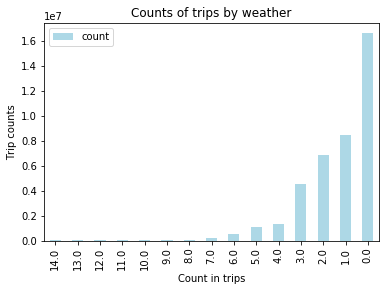

In [45]:
import matplotlib.pyplot as plt
%matplotlib inline

x_labels = weatherPDF['weathertype'].values
fig = weatherPDF[['count']].plot(kind='bar', facecolor='lightblue')
fig.set_xticklabels(x_labels)
fig.set_title('Counts of trips by weather')
fig.set_xlabel('Count in trips')
fig.set_ylabel('Trip counts')
plt.show()

#### Location Overview

In [24]:
rides2 = rides.sample(False, 0.01, seed=0)

TOP 5 PICKUP LOCATIONS

In [85]:
TopPickups = rides2.filter(('pickupArea = Near North Side \n
                            or pickupArea = Near West Side')).groupBy('pickupArea').count()

SyntaxError: EOL while scanning string literal (<ipython-input-85-08171778d071>, line 1)

CROSS TAB -- HOW TO FILTER DOWN TO TOP 5 OR 10 Pairs?

In [78]:
LocationCrossTab = pd.crosstab(rides2PDF.pickupArea, rides2PDF.dropoffArea)
LocationCrossTab

dropoffArea,Albany Park,Archer Heights,Armour Square,Ashburn,Auburn Gresham,Austin,Avalon Park,Avondale,Belmont Cragin,Beverly,...,Washington Heights,Washington Park,West Elsdon,West Englewood,West Garfield Park,West Lawn,West Pullman,West Ridge,West Town,Woodlawn
pickupArea,,,,,,,,,,,,,,,,,,,,,
Albany Park,248,3,3,1,1,22,0,107,65,0,...,0,2,1,1,2,0,0,94,102,0
Archer Heights,2,70,2,27,1,8,0,3,3,0,...,0,2,40,3,1,70,0,0,11,5
Armour Square,5,3,92,2,13,0,0,9,1,2,...,3,2,1,7,2,2,3,2,54,20
Ashburn,0,27,2,102,51,4,3,1,4,20,...,21,3,8,31,3,58,5,1,9,6
Auburn Gresham,0,5,8,75,312,10,18,0,0,34,...,106,31,6,93,4,17,24,2,14,48
Austin,20,5,1,10,10,1135,2,30,200,1,...,2,10,2,11,198,8,4,15,127,7
Avalon Park,0,1,0,3,19,6,29,0,0,0,...,5,11,0,7,1,2,4,0,4,19
Avondale,107,2,5,1,0,35,1,327,135,0,...,0,2,2,1,7,1,0,30,414,2
Belmont Cragin,44,5,1,0,0,187,0,106,599,0,...,1,1,2,3,9,5,0,22,114,0


In [31]:
#plt.figure(figsize=(8,5))
#sns.countplot(y=fareOverview['fare'])
#plt.title("Distribution of Pickup Area")

TOP 10 PICKUP LOCATIONS (# of RIDES)

In [73]:
rides2.select('pickupArea','dropoffArea').groupby('pickupArea').count().orderBy(desc("count")).show(10)

+---------------+-----+
|     pickupArea|count|
+---------------+-----+
|Near North Side|70869|
| Near West Side|37650|
|           Loop|37243|
|       Lakeview|29513|
|      West Town|27491|
|   Lincoln Park|24026|
|   Logan Square|16322|
|         Uptown| 9015|
|Near South Side| 8040|
|         O'Hare| 7646|
+---------------+-----+
only showing top 10 rows



TOP 10 DROPOFF LOCATIONS (# of RIDES)

In [29]:
fareLocation.groupby('dropoffArea').count().orderBy(desc("count")).show(10)

+---------------+-----+
|    dropoffArea|count|
+---------------+-----+
|Near North Side|34230|
|           Loop|20962|
| Near West Side|19193|
|       Lakeview|14448|
|      West Town|12826|
|   Lincoln Park|11949|
|   Logan Square| 7936|
|         O'Hare| 5285|
|         Uptown| 4437|
|Near South Side| 4004|
+---------------+-----+
only showing top 10 rows



In [112]:
rides.select('pickupLat', 'pickupLong').show(5)

+-------------+--------------+
|    pickupLat|    pickupLong|
+-------------+--------------+
|41.9581548757|-87.6530217894|
|41.7402057565|-87.6159695226|
|41.8785943576|-87.7302324284|
|41.7788768603|-87.5949254391|
|41.9850151008|-87.8045320063|
+-------------+--------------+
only showing top 5 rows



### Map Visualizations

https://towardsdatascience.com/a-complete-guide-to-an-interactive-geographical-map-using-python-f4c5197e23e0

Bokeh Map of Chicago

In [92]:
#! pip install geopandas

In [96]:
#import geopandas as gpd
import matplotlib.pyplot as plt
% matplotlib inline

from bokeh.plotting import figure, show, output_file
from bokeh.tile_providers import *
from bokeh.plotting import figure, show, output_notebook
from bokeh.tile_providers import CARTODBPOSITRON

In [116]:
pickups = rides2.select('pickupLat', 'pickupLong','dropoffLat','dropoffLong')
pickupsPDF = pickups.toPandas()

PICKUPS SCATTER PLOT

In [121]:
p = figure(plot_width = 600, plot_height = 400, title = 'Pickups')
x = pickupsPDF['pickupLong']
y =  pickupsPDF['pickupLat']
p.circle(x, y, color = 'blue', alpha = 0.1, size = 5)

output_notebook()
show(p)


Loading BokehJS ...

DROPOFFS SCATTER PLOT

In [128]:
p = figure(plot_width = 600, plot_height = 400, title = 'Pickups')
x = pickupsPDF['dropoffLong']
y =  pickupsPDF['dropoffLat']
p.circle(x, y, color = 'green', alpha = 0.1, size = 5)

output_notebook()
show(p)

Loading BokehJS ...

In [99]:
p = figure(x_range=(-9780000, -9745000), y_range=(5130000, 5160000),
           x_axis_type="linear", y_axis_type="linear")
p.add_tile(CARTODBPOSITRON)
output_notebook()
show(p)

Loading BokehJS ...

In [127]:
p = figure(x_range=(-9780000, -9745000), y_range=(-9780000, -9745000),
           x_axis_type="linear", y_axis_type="linear")
p.add_tile(CARTODBPOSITRON)
x = pickupsPDF['pickupLong']
y =  pickupsPDF['pickupLat']
p.circle(x, y, color = 'blue', alpha = 0.1, size = 5)
output_notebook()
show(p)

Loading BokehJS ...

###### Plot Heatmaps of Pickups & Dropoffs
Dropoffs

https://www.kaggle.com/aiswaryaramachandran/eda-and-feature-engineering

(-8080000, -8745000)

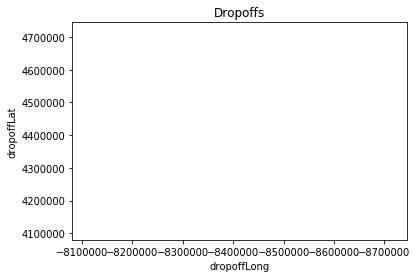

In [125]:
city_long_border = (-8080000, -8745000)
city_lat_border = (4080000, 4745000)

rides2PDF.plot(kind='scatter', x='dropoffLong', y='dropoffLat',
                color='green', 
                s=.02, alpha=.6)
plt.title("Dropoffs")

plt.ylim(city_lat_border)
plt.xlim(city_long_border)

Pickups

(-8080000, -8745000)

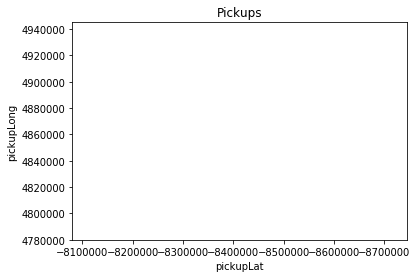

In [113]:
city_long_border = (-8080000, -8745000)
city_lat_border = (4780000, 4945000)

pickupsPDF.plot(kind='scatter', x='pickupLat', y='pickupLong',
                color='blue', 
                s=.02, alpha=.6)
plt.title("Pickups")

plt.ylim(city_lat_border)
plt.xlim(city_long_border)

##### GRAPH MODELS

https://towardsdatascience.com/graphframes-in-jupyter-a-practical-guide-9b3b346cebc5

https://towardsdatascience.com/large-scale-graph-mining-with-spark-part-2-2c3d9ed15bb5

In [54]:
! pip install graphframes

Could not install packages due to an EnvironmentError: [Errno 13] Permission denied: '/usr/local/Anaconda3-5.1.0/lib/python3.6/site-packages/graphframes'
Consider using the `--user` option or check the permissions.

You are using pip version 10.0.1, however version 19.1.1 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.


In [53]:
from functools import reduce
from pyspark.sql.functions import col, lit, when
from graphframes import *

ModuleNotFoundError: No module named 'graphframes'